In [1]:
#libraries
import torch
import models
import os
import yaml
import numpy as np
from PIL import Image
from patchify import patchify, unpatchify
import matplotlib.pyplot as plt
from skimage.exposure import equalize_hist
import math
from skimage.metrics import structural_similarity as ssim
import torch.nn as nn
from torchvision.transforms import Resize
import cv2

In [2]:
device=torch.device('cuda')
torch.cuda.device_count()

3

In [3]:
amp = 25
dir = '/home/gpu/girish/results_clrimg_resized/_unet_basic_25_raw_test_patch'
raw = True
monochrome= False
resize = False
train =  True

In [4]:
def psnr(pred, out, rgb_range=1):
    '''
    inp: patch_count * channels * H * W
    pred: patch_count * channels * H * W
    '''
    diff = (pred - out)/ rgb_range
    mse = torch.mean(torch.pow(diff, 2))

    return -10 * torch.log10(mse)

In [5]:
# The Required Preprocessing 
""" 
Hmm. This code can be mereged with the visualzie_train/test
"""
def image_transform(img, amp=False, raw=False, output=False, resize = False):
    # Here where we should be working 
    if raw:
        """ 
        Experiment
        # """
        # # Loading the file 
        # arr = np.array(Image.open(img))
        # arr = torch.from_numpy(arr/255)
        # if output == False:
        #     raw_h, raw_w = arr.shape
        #     r = np.zeros((raw_h // 2, raw_w // 2, 1))
        #     g1 = np.zeros((raw_h // 2, raw_w // 2, 1))
        #     g2 = np.zeros((raw_h // 2, raw_w // 2, 1))
        #     b = np.zeros((raw_h // 2, raw_w // 2, 1))
        #     r = img[0::2, 0::2]  # r
        #     g1 = img[0::2, 1::2]  # gr
        #     g2 = img[1::2, 0::2]  # gb
        #     b = img[1::2, 1::2]  # b
        #     img_unpack = np.dstack((r, g1, g2, b)) 
        #     # print(img_unpack.shape, 'image unpack shape')
        #     if amp:
        #         img_unpack_amp = np.clip(img_unpack*amp,0,1)
        # else:
        #     img_unpack_amp = img
        # img_unpack_amp = np.transpose(img_unpack_amp , (2,0,1))        
        # # print(img_unpack_amp.shape, 'before resizing shape')
        # if resize:
        #     resizer = Resize([512,512])
        #     img_unpack_amp_resize = resizer(torch.from_numpy(img_unpack_amp))

        """ 
        The Original 
        """
        img = cv2.imread(img, -1)
        # img = img / 255.0
        # Unpacking


        # Cropping
        img = img[:2048, :]
        # print(img.shape, 'should have cropped and 1024 x 4096')


        if output == False:

            raw_h, raw_w = img.shape
            r = np.zeros((raw_h // 2, raw_w // 2, 1))
            g1 = np.zeros((raw_h // 2, raw_w // 2, 1))
            g2 = np.zeros((raw_h // 2, raw_w // 2, 1))
            b = np.zeros((raw_h // 2, raw_w // 2, 1))
            r = img[0::2, 0::2]  # r
            g1 = img[0::2, 1::2]  # gr
            g2 = img[1::2, 0::2]  # gb
            b = img[1::2, 1::2]  # b
            img_arr = np.dstack((r, g1, g2, b)) 
            img = torch.from_numpy(img_arr / 255).permute(2, 0, 1).unsqueeze(0)
            # print(img_unpack.shape, 'image unpack shape')
            if amp:
                print('yes')
                img_unpack_amp = (img*amp).clamp_(0,1)
        else:
            img = torch.from_numpy(img/255).permute(2, 0, 1).unsqueeze(0)
            img_unpack_amp = img
        # img_unpack_amp = np.transpose(img_unpack_amp , (2,0,1))        
        # print(img_unpack_amp.shape, 'before resizing shape')
        if resize:
            resizer = Resize([512,512])
            img_unpack_amp_resize = resizer(img_unpack_amp)
        else:
            img_unpack_amp_resize = img_unpack_amp
        # print(img_unpack_amp_resize.shape, 'After resizing')
        
    else:
        arr = np.array(Image.open(img))
        if len(arr.shape)==3:
            pass
        elif len(arr.shape)==2:
            arr = np.repeat(np.expand_dims(arr, axis=2), 3, axis=2)
    # arr = torch.from_numpy(arr/255)
    # if amp:
        # print(arr.shape, 'Shape in here')
        # amp = amp_module(arr, 0.5)
        # amp_arr = (arr*amp).clamp_(0,1)
        # arr = amp_arr
    # res, h, w, p_x, p_y = patchify_img(np.array(arr), patch_size=512)
    # arr = torch.from_numpy(res).permute(0, 3, 1, 2)
    # if amp:
        # return arr, h, w, p_x, p_y, amp, amp_arr
    # else:
        # return arr, h, w, p_x, p_y
    # print(img_unpack_amp_resize.shape, 'input to the model')
    return img_unpack_amp_resize
    

In [6]:
epochs = ['10', '20', '30', '40', '50', 'best-psnr'] 
# epochs = ['40', 50', 'best-psnr']
file = '25.png'
with open(os.path.join(dir, 'test_config.yaml'), 'r') as f:
        config = yaml.load(f, Loader=yaml.FullLoader)
if config['test_dataset']['dataset']['args'].get('root_path_inp') is not None:
    test_dir = config['test_dataset']['dataset']['args']['root_path_inp']
    out_dir = config['test_dataset']['dataset']['args']['root_path_out']

gt = image_transform(os.path.join(out_dir, file), raw=raw, output=True, resize=False)
res = image_transform(os.path.join(test_dir,file), amp = amp, raw = raw, resize = resize)
res = torch.reshape(res, (1, 4, 1024, 2048)).float()
imgs = []

for epoch in epochs:

    model_path = '/home/gpu/girish/results_clrimg_resized/_unet_basic_25_raw_test_patch/epoch-'+epoch+'.pth'
    sv_file = torch.load(model_path, map_location=device)
    model = models.make(sv_file['model'], load_sd=True).eval().cuda()
    model = nn.DataParallel(model)


    with torch.no_grad():
        pred = model((res-0.5)/0.5)*0.5+0.5
    imgs.append(pred)

    torch.cuda.empty_cache()

model_path = '/home/gpu/girish/results_clrimg_resized/_unet_basic_25_raw_test/epoch-best-psnr.pth'
sv_file = torch.load(model_path, map_location=device)
model = models.make(sv_file['model'], load_sd=True).eval().cuda()
model = nn.DataParallel(model)
with torch.no_grad():
    pred = model((res-0.5)/0.5)*0.5+0.5
imgs.append(pred)
epochs.append('unpatched Training')



yes


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


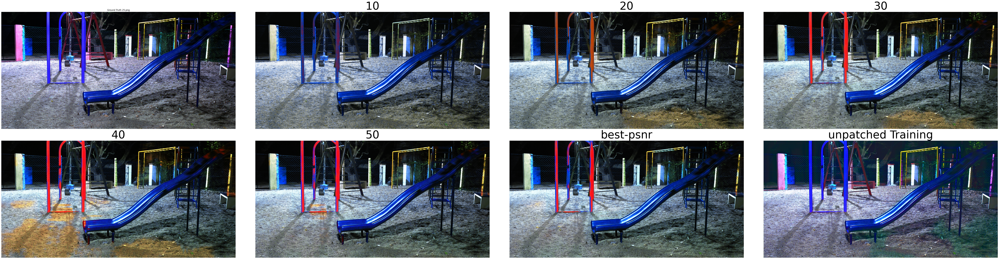

In [7]:
file_name = file
plt.figure(figsize=(100, 50))
plt.subplot(4, 4, 1)
gt = torch.reshape(gt, (3, 2048, 4096))
resizer = Resize([1024, 2048])
gt = resizer(gt)
gt = torch.permute(gt, (1, 2 , 0)).detach().cpu().numpy()
gt = gt[:, :, [2,1,0]]
plt.title('Ground Truth {}'.format(file_name) )
plt.imshow(gt, 'gray')
plt.axis('off')
for i in range(len(imgs)):
    plt.subplot(4,4,i+2)
    
    # if resize:
    #     img = torch.reshape(imgs[i], (1, 4, 512, 512)).float()
    # else:
    #     img = torch.reshape(imgs[i], (1, 4, 1024, 2048)).float()
    # pred = model((img - 0.5)/0.5)*0.5+0.5
    # pred = torch.reshape(pred, (3, 1024, 2048))
    # # if resize:
    # #     resizer = Resize([2160,4096])
    # #     pred = resizer(pred)
    imgs[i] = torch.reshape(imgs[i], (3, 1024, 2048))
    imgs[i] = torch.permute(imgs[i], (1, 2 , 0)).detach().cpu().numpy()
    plt.title(epochs[i], fontsize = 60)
    plt.imshow(imgs[i], 'gray')
    plt.axis('off')

    # plt.subplot(2, 2, 3)
    # plt.title('Difference Between Output and Input')
    # plt.imshow(abs(gt - pred), 'gray')
    # plt.axis('off')


plt.subplots_adjust(wspace =0.01, hspace = 0.1)
path ='/home/gpu/girish/enhancement/results_comparisons'
plt.savefig(os.path.join(path, file_name), )
plt.show()
    
